In [2]:
import sys
sys.path.insert(0, '../python_lib')
import numpy as np
import torch
import graph_gen
import models
from models.spins_model import model
import importlib


# Spin system on fully connected

In [147]:
N=20
J_val = 1
h_val = 0


In [148]:
importlib.reload(models.spins_model)
import models
from models.spins_model import model



In [199]:
N

20

In [206]:
k=21
binom(N, k)

0.0

In [247]:
N

165

In [309]:
from scipy.special import binom, logsumexp

def log_binom(n, m):
    assert(n>0)
    if m == 0 or n==m: return 0
    else:
        first = n*np.log(n) - m*np.log(m) - (n-m)*np.log(n-m)
        correction = np.log(n) - np.log(m) - np.log(n-m) - np.log(2.*np.pi)
        return first  + 0.5 * correction

class curie_weiss(model):
    def exact_N(self, beta):
        N = self.N
        J = self.J[0][0]
        h = self.H[0]
        print(J, h)
        m = np.zeros(N+1)
        m_abs = np.zeros(N+1)
        Z = np.zeros(N+1)
        e = np.zeros(N+1)
        f = np.zeros(N+1)
        for k in np.arange(0, N+1):
            m_k = N - 2.*k
            h_k = - h * m_k
            j_k = - J * m_k * m_k
            z_k = log_binom(N, k) - beta * (h_k + j_k)
            Z[k] = z_k
            e[k]= (h_k + j_k)
            m[k]= - h_k
            m_abs[k]= - np.abs(h_k)
            print(z_k)
        self.Zs = Z
        Zs_max = np.exp(Z - np.max(Z))
        self.free_energy = - logsumexp(Z) / (N * beta)
        self.E_mean = np.average(e, weights=Zs_max) / N
        self.S = beta * self.E_mean - beta * self.free_energy
        self.M_mean = np.average(m, weights=Zs_max) / N
        self.M_abs_mean = np.average(m_abs, weights=Zs_max) / N
        
        print(
            "beta: {2:.1f}, Fe: {0:.3f}".format(
                self.free_energy, self.E_mean - (1.0 / beta) * self.S, beta
            ),
            end=" ",
        )
        print(
            f"Energy: {self.E_mean:.3} M: {self.M_mean:.3} M_abs: {self.M_abs_mean:.3} S: {self.S:.3}"
        )

        return self.free_energy



In [310]:
beta=2
N = 150
J_val = 1
J_interaction = torch.ones((N,N))
J = (J_val / (2*N)) * J_interaction
h = h_val * torch.ones(N)
curie_weiss_fast = curie_weiss(N, h, J, J_interaction)
curie_weiss_fast.exact_N(beta)


tensor(0.0033) tensor(0.)
tensor(150.)
tensor(151.1184)
tensor(151.4695)
tensor(151.4877)
tensor(151.2716)
tensor(150.8817)
tensor(150.3572)
tensor(149.7258)
tensor(149.0077)
tensor(148.2185)
tensor(147.3704)
tensor(146.4734)
tensor(145.5357)
tensor(144.5641)
tensor(143.5646)
tensor(142.5422)
tensor(141.5012)
tensor(140.4455)
tensor(139.3785)
tensor(138.3033)
tensor(137.2226)
tensor(136.1387)
tensor(135.0540)
tensor(133.9704)
tensor(132.8897)
tensor(131.8136)
tensor(130.7437)
tensor(129.6814)
tensor(128.6279)
tensor(127.5846)
tensor(126.5524)
tensor(125.5325)
tensor(124.5258)
tensor(123.5332)
tensor(122.5556)
tensor(121.5938)
tensor(120.6485)
tensor(119.7204)
tensor(118.8102)
tensor(117.9184)
tensor(117.0456)
tensor(116.1925)
tensor(115.3595)
tensor(114.5470)
tensor(113.7556)
tensor(112.9857)
tensor(112.2377)
tensor(111.5119)
tensor(110.8087)
tensor(110.1285)
tensor(109.4716)
tensor(108.8382)
tensor(108.2287)
tensor(107.6434)
tensor(107.0824)
tensor(106.5461)
tensor(106.0346)
tensor(10

-0.5125626566941791

In [311]:
curie_weiss_model = model(N, h, J, J_interaction)


In [312]:
curie_weiss_model.exact(beta, chunk=10000)


AssertionError: 

In [313]:
torch.linspace(5,25, 5)

tensor([ 5., 10., 15., 20., 25.])

In [314]:
Ssd = {}
Fesd = {}
Msd = {}
betas = np.linspace(0.1,2, 100)
Ns = np.arange(10,2000, 200)
for N in Ns:
    print(N)
    J_interaction = torch.ones((N,N))
    J = (J_val / (2*N)) * J_interaction
    h = h_val * torch.ones(N)
    Ss = []
    Fes = []
    Ms = []
    curie_weiss_model = curie_weiss(N, h, J, J_interaction)
    for beta in betas:
        res = curie_weiss_model.exact_N(beta)
        Ss.append(curie_weiss_model.S)
        Fes.append(curie_weiss_model.free_energy)
        Ms.append(curie_weiss_model.M_mean)
    Ssd[N] = Ss    
    Msd[N] = Ms    
    Fesd[N] = Fes

10
tensor(0.0500) tensor(0.)
tensor(0.5000)
tensor(2.7046)
tensor(4.0301)
tensor(4.8987)
tensor(5.3934)
tensor(5.5544)
tensor(5.3934)
tensor(4.8987)
tensor(4.0301)
tensor(2.7046)
tensor(0.5000)
beta: 0.1, Fe: -7.014 Energy: -0.0555 M: 0.0 M_abs: 0.0 S: 0.696
tensor(0.0500) tensor(0.)
tensor(0.5960)
tensor(2.7660)
tensor(4.0646)
tensor(4.9141)
tensor(5.3973)
tensor(5.5544)
tensor(5.3973)
tensor(4.9141)
tensor(4.0646)
tensor(2.7660)
tensor(0.5960)
beta: 0.1, Fe: -5.894 Energy: -0.0566 M: 0.0 M_abs: 0.0 S: 0.696
tensor(0.0500) tensor(0.)
tensor(0.6919)
tensor(2.8274)
tensor(4.0992)
tensor(4.9294)
tensor(5.4011)
tensor(5.5544)
tensor(5.4011)
tensor(4.9294)
tensor(4.0992)
tensor(2.8274)
tensor(0.6919)
beta: 0.1, Fe: -5.084 Energy: -0.0576 M: 0.0 M_abs: 0.0 S: 0.696
tensor(0.0500) tensor(0.)
tensor(0.7879)
tensor(2.8888)
tensor(4.1337)
tensor(4.9448)
tensor(5.4050)
tensor(5.5544)
tensor(5.4050)
tensor(4.9448)
tensor(4.1337)
tensor(2.8888)
tensor(0.7879)
beta: 0.2, Fe: -4.472 Energy: -0.0588 

(0.68, 0.694)

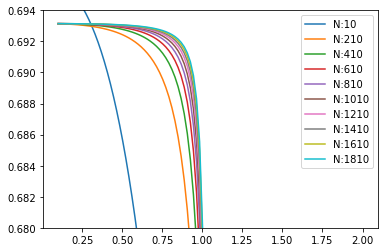

In [322]:
import matplotlib.pyplot as plt
for N in Fesd:  
    plt.plot(betas, torch.Tensor(Ssd[N]), label=f"N:{N}")
plt.legend()
plt.ylim(0.68,0.694)

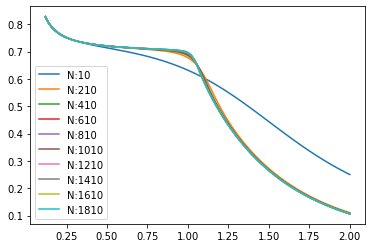

In [323]:
import matplotlib.pyplot as plt
for N in Fesd:  
    x = torch.Tensor(Fesd[N])
    dx = (x[1:] - x[:-1])/ (betas[1] - betas[0])
    Bs = torch.Tensor(betas[1:])
    plt.plot(betas[1:], Bs*Bs*dx, label=f"N:{N}")
plt.legend()

In [169]:
Ssd = {}
Fesd = {}
Msd = {}
for N in Ns:
    print(N)
    J_interaction = torch.ones((N,N))
    J_interaction.fill_diagonal_(0.)
    J = (J_val / (2*N)) * J_interaction
    h = h_val * torch.ones(N)
    Ss = []
    Fes = []
    Ms = []
    curie_weiss_model = model(N, h, J, J_interaction)
    for beta in betas:
        res = curie_weiss_model.exact(beta, chunk=10000)
        Ss.append(curie_weiss_model.S)
        Fes.append(curie_weiss_model.free_energy)
        Ms.append(curie_weiss_model.M_mean)
    Ssd[N] = Ss    
    Msd[N] = Ms    
    Fesd[N] = Fes

5
beta: 0.1, Fe: -6.936 Energy: -0.0085 M: 1.49e-09 S: 0.685
beta: 0.2, Fe: -3.474 Energy: -0.0181 M: -9.6e-09 S: 0.677
beta: 0.3, Fe: -2.324 Energy: -0.0288 M: 2.92e-09 S: 0.668
beta: 0.4, Fe: -1.752 Energy: -0.0408 M: -9.33e-09 S: 0.66
beta: 0.5, Fe: -1.411 Energy: -0.0541 M: 2.38e-08 S: 0.651
beta: 0.6, Fe: -1.186 Energy: -0.0688 M: -1.36e-08 S: 0.643
beta: 0.7, Fe: -1.027 Energy: -0.0849 M: 0.0 S: 0.634
beta: 0.8, Fe: -0.911 Energy: -0.102 M: 1.25e-08 S: 0.626
beta: 0.9, Fe: -0.822 Energy: -0.121 M: -1.18e-08 S: 0.619
beta: 1.0, Fe: -0.753 Energy: -0.14 M: 1.33e-08 S: 0.613
beta: 1.1, Fe: -0.698 Energy: -0.16 M: -2.46e-08 S: 0.608
beta: 1.2, Fe: -0.654 Energy: -0.18 M: -2.64e-08 S: 0.604
beta: 1.3, Fe: -0.618 Energy: -0.201 M: 6.86e-09 S: 0.603
beta: 1.4, Fe: -0.589 Energy: -0.221 M: -3.09e-08 S: 0.604
beta: 1.5, Fe: -0.565 Energy: -0.24 M: -2.75e-08 S: 0.608
beta: 1.6, Fe: -0.546 Energy: -0.258 M: 0.0 S: 0.614
beta: 1.7, Fe: -0.529 Energy: -0.276 M: 1.27e-08 S: 0.624
beta: 1.8, Fe

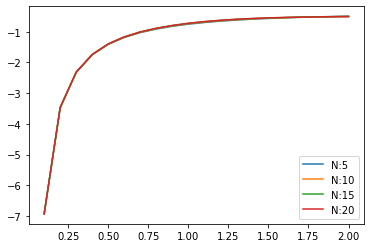

In [170]:
import matplotlib.pyplot as plt
for N in Fesd:  
    plt.plot(betas, torch.Tensor(Fesd[N]), label=f"N:{N}")
plt.legend()

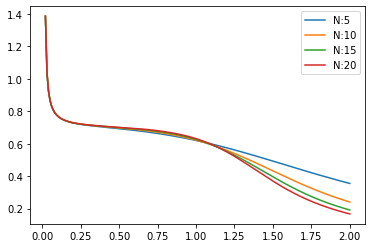

In [162]:
import matplotlib.pyplot as plt
for N in Fesd:  
    x = torch.Tensor(Fesd[N])
    dx = (x[1:] - x[:-1])/ (betas[1] - betas[0])
    Bs = torch.Tensor(betas[1:])
    plt.plot(betas[1:], Bs*Bs*dx, label=f"N:{N}")
plt.legend()

In [92]:
x[:-1]

tensor([    -inf, -68.9683, -34.4843, -22.9897, -17.2425, -13.7942, -11.4954,
         -9.8535,  -8.6220,  -7.6643,  -6.8981,  -6.2712,  -5.7489,  -5.3069,
         -4.9281,  -4.5998,  -4.3126,  -4.0592,  -3.8340,  -3.6325,  -3.4511,
         -3.2871,  -3.1379,  -3.0018,  -2.8770,  -2.7622,  -2.6563,  -2.5582,
         -2.4672,  -2.3824,  -2.3033,  -2.2293,  -2.1600,  -2.0949,  -2.0336,
         -1.9758,  -1.9213,  -1.8697,  -1.8209,  -1.7745,  -1.7305,  -1.6887,
         -1.6488,  -1.6109,  -1.5746,  -1.5400,  -1.5070,  -1.4753,  -1.4450,
         -1.4159,  -1.3880,  -1.3612,  -1.3354,  -1.3107,  -1.2868,  -1.2639,
         -1.2418,  -1.2204,  -1.1999,  -1.1800,  -1.1608,  -1.1423,  -1.1243,
         -1.1070,  -1.0902,  -1.0740,  -1.0582,  -1.0430,  -1.0282,  -1.0138,
         -0.9999,  -0.9864,  -0.9733,  -0.9606,  -0.9482,  -0.9362,  -0.9245,
         -0.9131,  -0.9021,  -0.8913,  -0.8808,  -0.8707,  -0.8607,  -0.8511,
         -0.8417,  -0.8325,  -0.8236,  -0.8149,  -0.8064,  -0.79

(-10.0, 0.0)

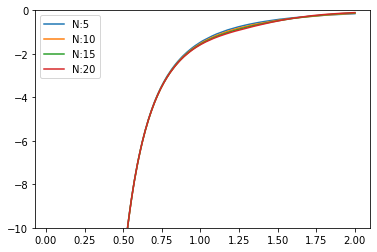

In [91]:
import matplotlib.pyplot as plt
for N in Fesd:  
    x = torch.Tensor(Fesd[N])
    dx = (x[1:] - x[:-1])/ (betas[1] - betas[0])
    ddx = (dx[1:] - dx[:-1])/ (betas[1] - betas[0])
    Bs = torch.Tensor(betas[2:])
    plt.plot(betas[2:], ddx, label=f"N:{N}")
plt.legend()
plt.ylim(-10,0)

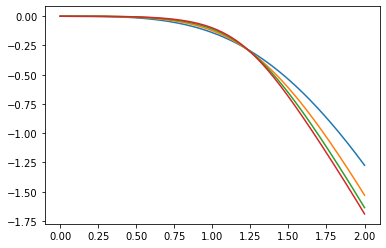

In [96]:
import matplotlib.pyplot as plt
for N in Fesd:  

    plt.plot(betas, torch.Tensor(Ssd[N]))

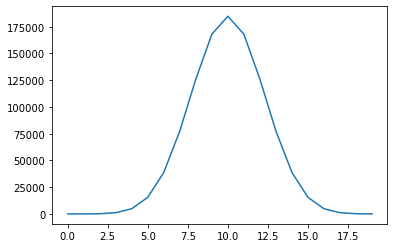

In [99]:
import scipy.special
fact = scipy.special.factorial
def binomial(n,k):
    return fact(n)/(fact(k)*fact(n-k))
n=20
ks = np.arange(0,n)
plt.plot(ks, binomial(n,ks)) 

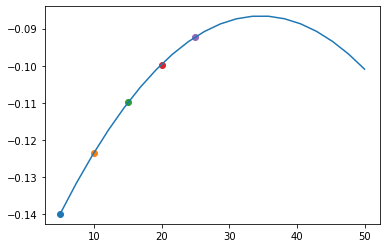

In [83]:
import matplotlib.pyplot as plt
x = []
y = []
for N in Fesd:  
    x.append(N)
    y.append(Ssd[N][10])
    plt.scatter([N], Ssd[N][10])
z = np.polyfit(x, y, 2)
p = np.poly1d(z)
xp = np.linspace(5, 50, 20)
plt.plot(xp, p(xp))


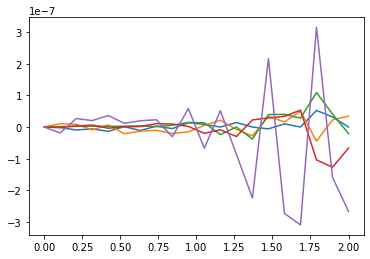

In [69]:
import matplotlib.pyplot as plt
for N in Fesd:  
    plt.plot(betas, torch.Tensor(Msd[N]))

In [6]:
curie_weiss_model.exact(0.1)

beta: 0.1, Fe: -6.972 Energy: -0.0566 M: 0.0552 S: 0.6913     


tensor(-6.9715)

In [7]:
def tan(beta, m, h):
    return np.tanh(beta*(m+h))

m=0.1
beta=0.1

In [8]:
h

tensor([0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000, 0.5000,
        0.5000, 0.5000])

In [19]:
diff = 1
beta=2
m=0.1
iter = 0
while diff > 1e-5:
    iter+=1
    m_star = tan(beta, m, 0)
    diff = abs(m_star - m)
    m = m_star
    print(f"\r{iter} -- {m:0.2} -- {diff:.5}", end="")

11 -- 0.96 -- 2.3502e-06

(0.0, 3.0)

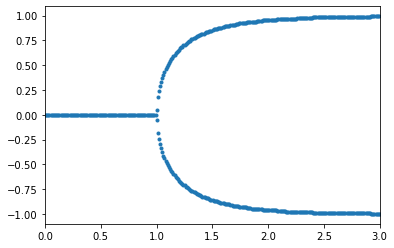

In [34]:
from typing import Iterable, Tuple
import numpy as np
import doctest
import matplotlib.pyplot as plt

def intersect(x: np.array, f: np.array, g: np.array) -> Iterable[Tuple[(int, int)]]:
    """
    Finds the intersection points between `f` and `g` on the domain `x`.
    Given:
        - `x`: The discretized domain.
        - `f`: The discretized values of the first function calculated on the
               discretized domain.
        - `g`: The discretized values of the second function calculated on the
               discretized domain.
    Returns:
        An iterable containing the (x,y) points of intersection.


    Test case, line-parabola intersection:
        
    >>> x = np.linspace(0, 10, num=10000)
    >>> f = 3 * x
    >>> g = np.square(x)
    >>> list(intersect(x, f, g))
    [(0.0, 0.0), (2.999299929992999, 8.997899789978998)]
    """
    idx = np.argwhere(np.diff(np.sign(f - g))).flatten()
    return zip(x[idx], f[idx])

def tan(beta, m, h):
    return np.tanh(beta*(m+h))
points = []
bx = []
for b in np.linspace(0,10,1000):
    ms = np.linspace(-3,3,1000)
    ys = tan(b, ms, h_val)
    #plt.plot(ms, ys)
    #plt.plot(ms[2000:8000], ms[2000:8000])
    zeros = np.array(list(intersect(ms,ys,ms)))
    if len(zeros) > 1:
        zeros = zeros[np.abs(zeros[:,0])>0.01]
    points.extend(zeros)
    bx.extend([b]*len(zeros))
#plt.plot(ms, ys)
points = np.array(points)
plt.plot(bx, points[:,0], ".")
plt.xlim(0,3)

# Exact solutions
enumerating all configurations.

In [54]:
curie_weiss_model.exact(beta)


NameError: name 'beta' is not defined

# Neural network solutions
## ordered case

In [56]:
from nets import ann_deep
imp.reload(ann_deep)
from models import spins_model
imp.reload(spins_model)
bias = True
neighs = [torch.arange(0,n) for n in range(N)]
in_out_layers = [[len(i),1] for i in neighs]
net = ann_deep.ann_deep(curie_weiss_model.N, in_out_layers, neighs)
ms_abs_net = []
betas_net = np.linspace(2,10,5)
for b in betas_net:
  net = ann_deep.ann_deep(curie_weiss_model.N, in_out_layers, neighs)
  ann_deep.train(net, 
          curie_weiss_model, 
          beta=b, 
          lr=0.001, 
          batch_size=1000,
          std_fe_limit=0.000005,
          max_step=1000 
  )
  ann_deep.train(net, 
          curie_weiss_model, 
          beta=b, 
          lr=0.001, 
          batch_size=2000,
          std_fe_limit=0.0001,
          max_step=10000 
  )
  s, prob = net.sample(10000)
  m_net = np.abs(s.detach().mean(axis=1)).mean()
  ms_abs_net.append(m_net)
#net.compute_stat(beta, batch_size=10000)

 2.00 6534 fe: -0.322 +- 0.00054 E: 0.013, S: 0.670, M: 0.0638

KeyboardInterrupt: 

(0.0, 10.0)

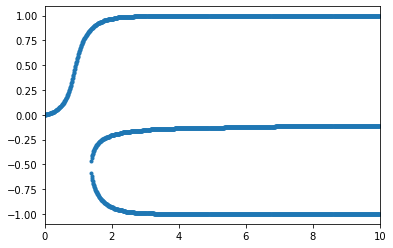

In [57]:
import matplotlib.pyplot as plt
plt.plot(bx, points[:,0], ".")
#plt.plot(bx, points[:,0]*points[:,0], ".")
plt.scatter(betas_net[:len(ms_abs_net)], ms_abs_net, color="red")
plt.xlim(0,10)

tensor(0.9409)


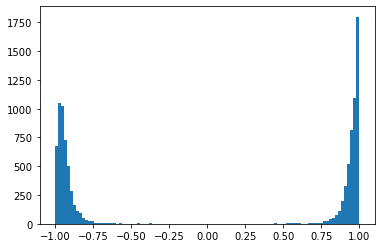

In [169]:
import matplotlib.pyplot as plt
plt.hist(s.detach().sum(axis=1)/N, bins=100);
print(np.abs(s.detach().sum(axis=1)/N).mean())

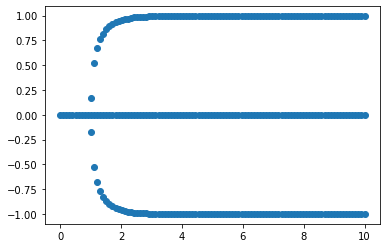

In [184]:
zeros = list(intersect(ms,ys,ms))
zeros

[(-0.9327932793279325, -0.9327350565724826),
 (-0.0003000300030002734, -0.0005382539534199857),
 (0.9321932193219324, 0.9325949641980728)]

In [186]:
zeros

[(-0.9327932793279325, -0.9327350565724826),
 (-0.0003000300030002734, -0.0005382539534199857),
 (0.9321932193219324, 0.9325949641980728)]

In [162]:
net.train(beta=beta, 
          lr=0.001, 
        batch_size=1000,
         std_fe_limit=0.00001, 
)


 1.80 592 fe: -0.391 +- 0.00027 E: -0.017, S: 0.673, M: 0.0214, B1 = 0.0010

KeyboardInterrupt: 

tensor(0.1230)


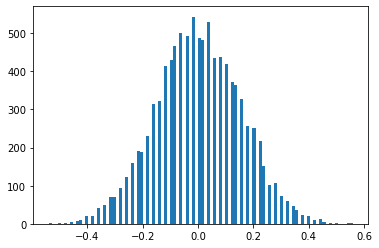

In [153]:
import matplotlib.pyplot as plt

plt.hist(s.detach().sum(axis=1)/N, bins=100);
print(np.abs(s.detach().sum(axis=1)/N).mean())

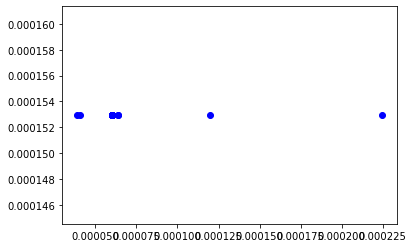

In [101]:
import matplotlib.pyplot as plt
plt.plot(net.M_i,curie_weiss_model.M_i_mean , 'bo')

# Large networks BP solution

In [124]:
import bp_solver
bp_sol = bp_solver.BP_solver(curie_weiss_model)

In [125]:
bp_sol.converge(beta)

fe: -21.951, ener: -0.189, M: 0.874, iter 18


In [69]:
bp_sol.free_energy(beta)

-9.606312916453007